In [ ]:
!pip install -U torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("discs", {}, "/content/drive/MyDrive/trainval.json", "/content/drive/MyDrive/newlast_resized")

In [ ]:
from detectron2.data import MetadataCatalog,DatasetCatalog
MetadataCatalog.get("discs").thing_classes = ["disc"]

In [ ]:
disc_metadata = MetadataCatalog.get("discs")

In [ ]:
disc_metadata

Metadata(evaluator_type='coco', image_root='/content/drive/MyDrive/newlast_resized', json_file='/content/drive/MyDrive/trainval.json', name='discs', thing_classes=['disc'])

In [ ]:
dataset_dicts = DatasetCatalog.get("discs")
import random
from detectron2.utils.visualizer import Visualizer
import cv2
from google.colab.patches import cv2_imshow


Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.



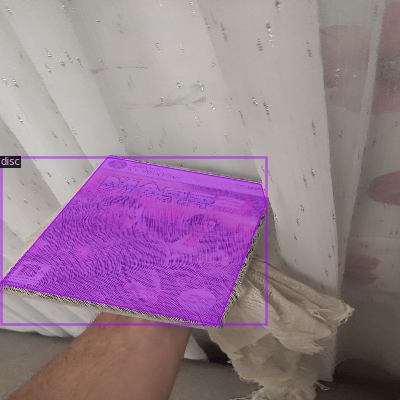

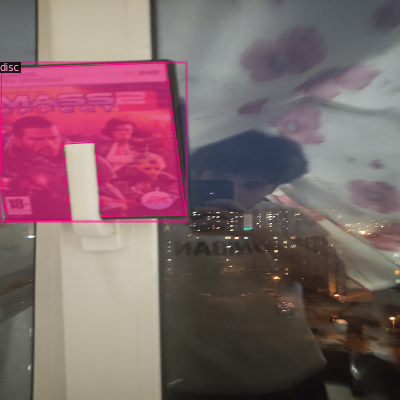

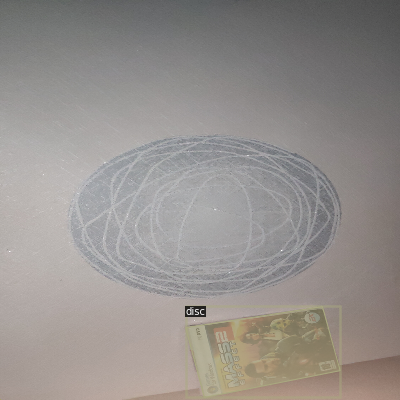

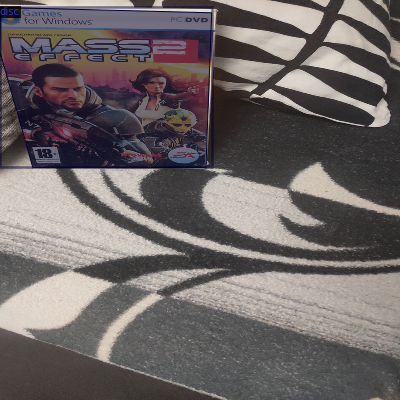

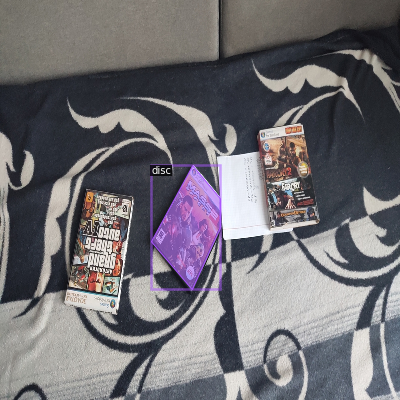

...

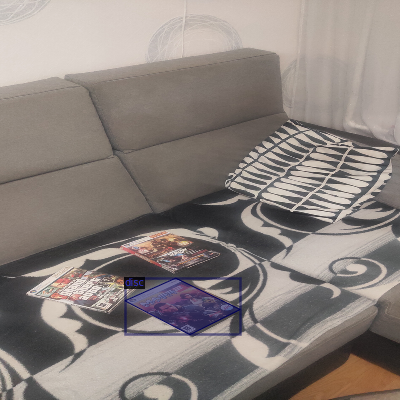

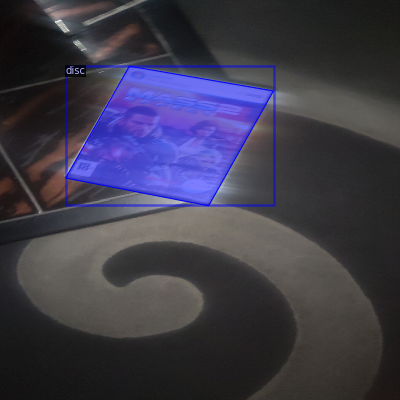

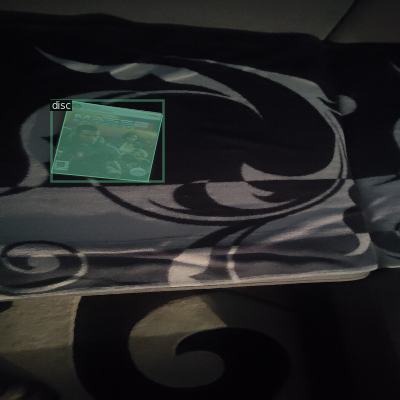

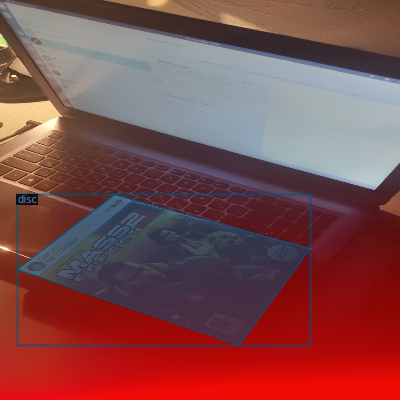

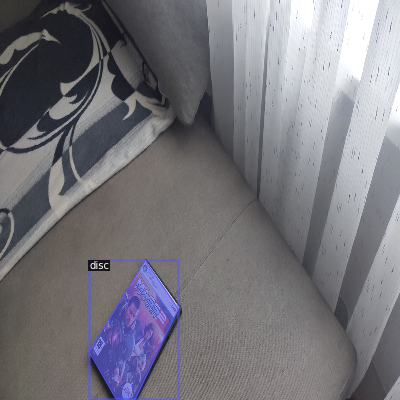

In [ ]:
for d in random.sample(dataset_dicts, 60):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=disc_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os
cfg = get_cfg()
cfg.merge_from_file(
    "/content/detectron2_repo/configs/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"
)
cfg.DATASETS.TRAIN = ("discs",)
cfg.DATASETS.TEST = ()  # no metrics implemented for this dataset
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = "detectron2://COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl"  # initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.02
cfg.SOLVER.MAX_ITER = (
    1000
)  # 300 iterations seems good enough, but you can certainly train longer
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = (
    128
)  # faster, and good enough for this toy dataset
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # 3 classes (data, fig, hazelnut)

In [ ]:
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg

In [ ]:
cfg.MODEL.WEIGHTS = '/content/drive/MyDrive/model_final.pth'
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8   # set the testing threshold for this model
cfg.DATASETS.TEST = ("discs", )
predictor = DefaultPredictor(cfg)

In [ ]:
from skimage.transform import ProjectiveTransform
from skimage.io import imread
import numpy as np
import matplotlib.pylab as plt


/content/detectron2_repo/detectron2/modeling/roi_heads/fast_rcnn.py:124: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  filter_inds = filter_mask.nonzero()


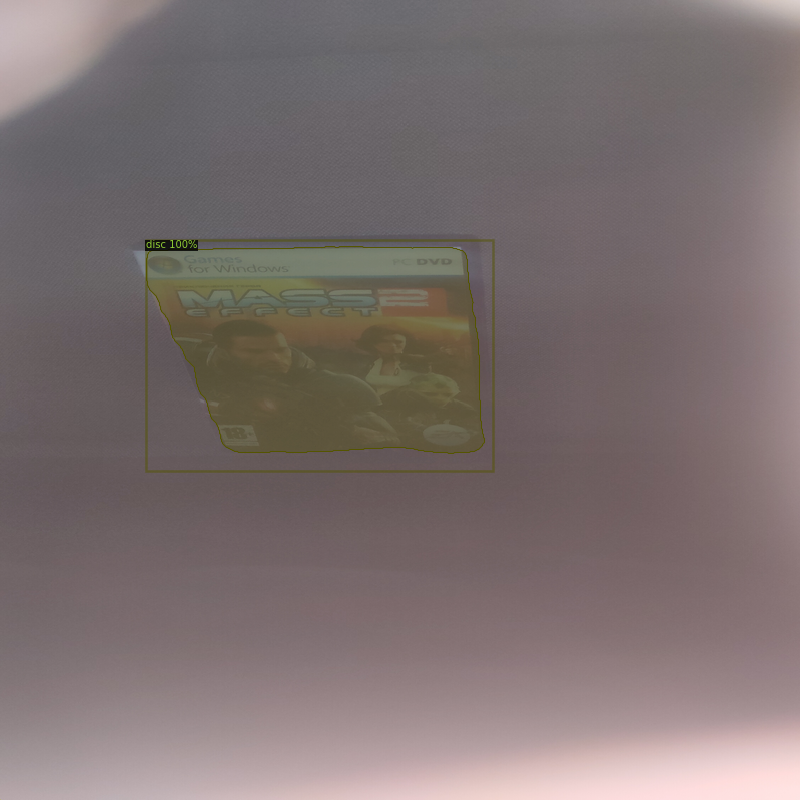

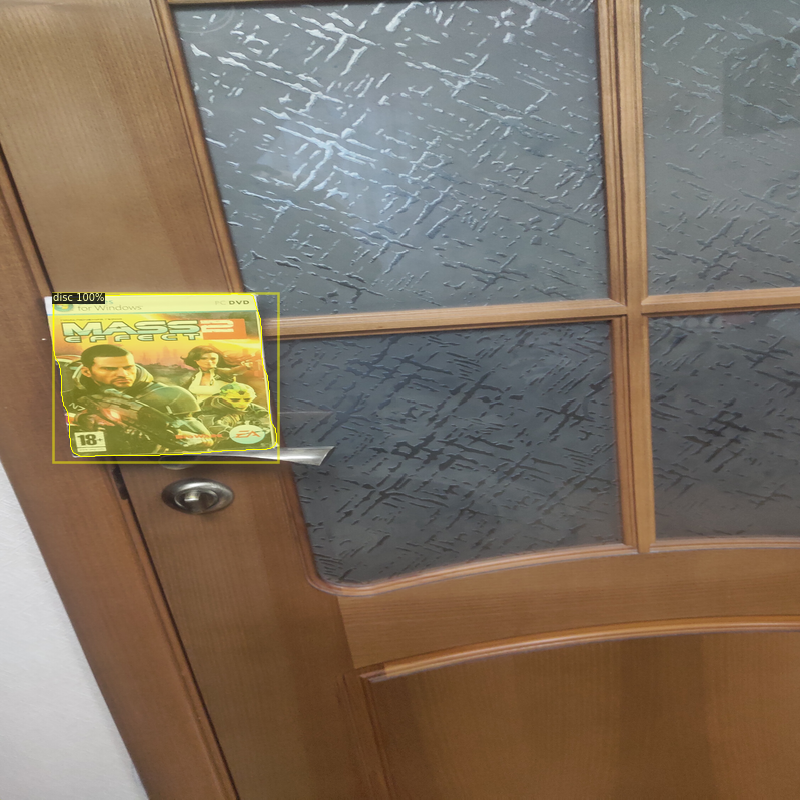

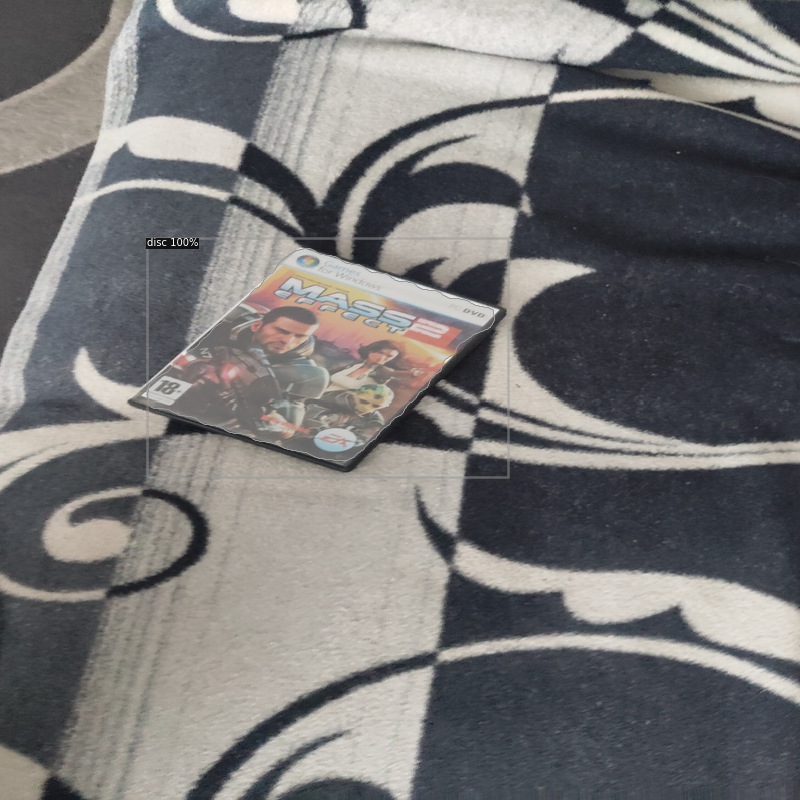

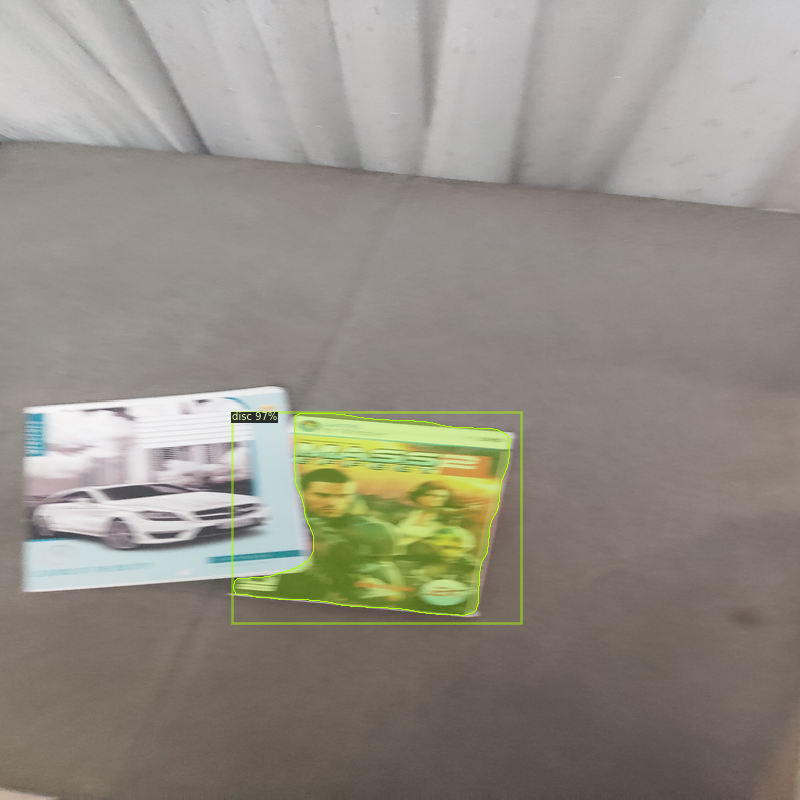

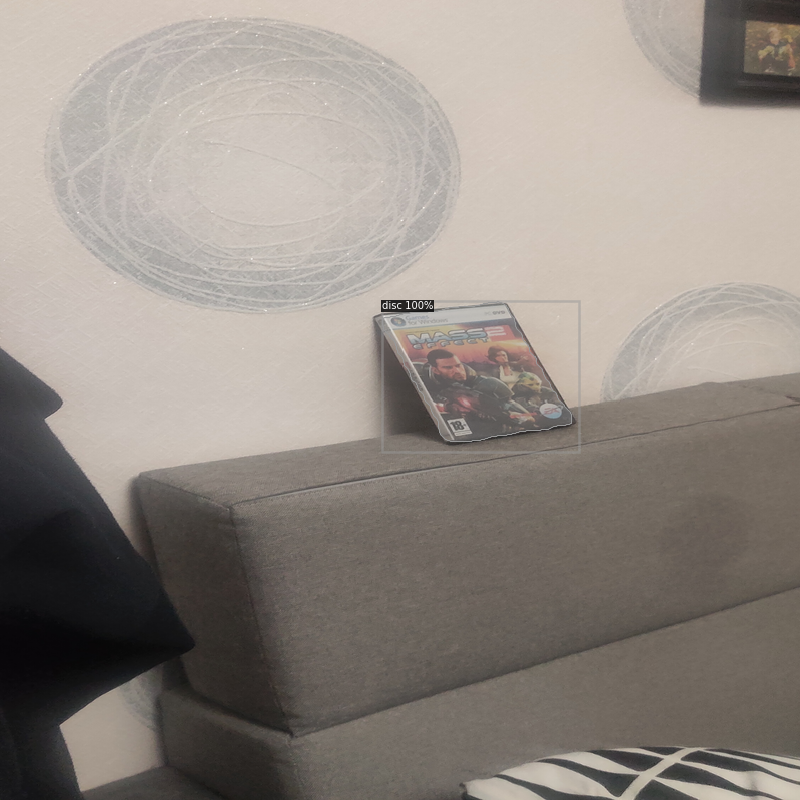

...

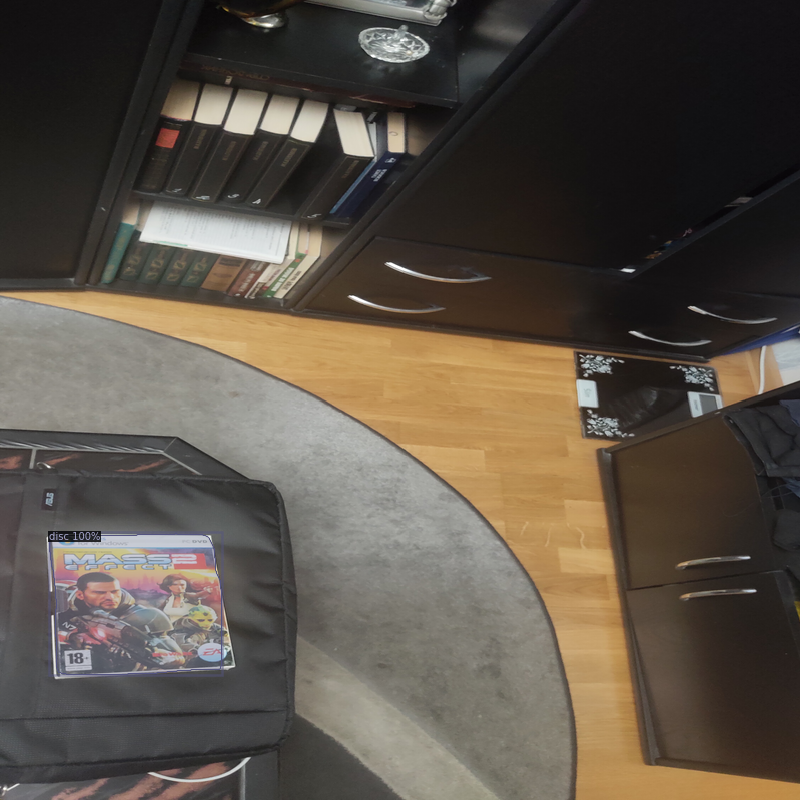

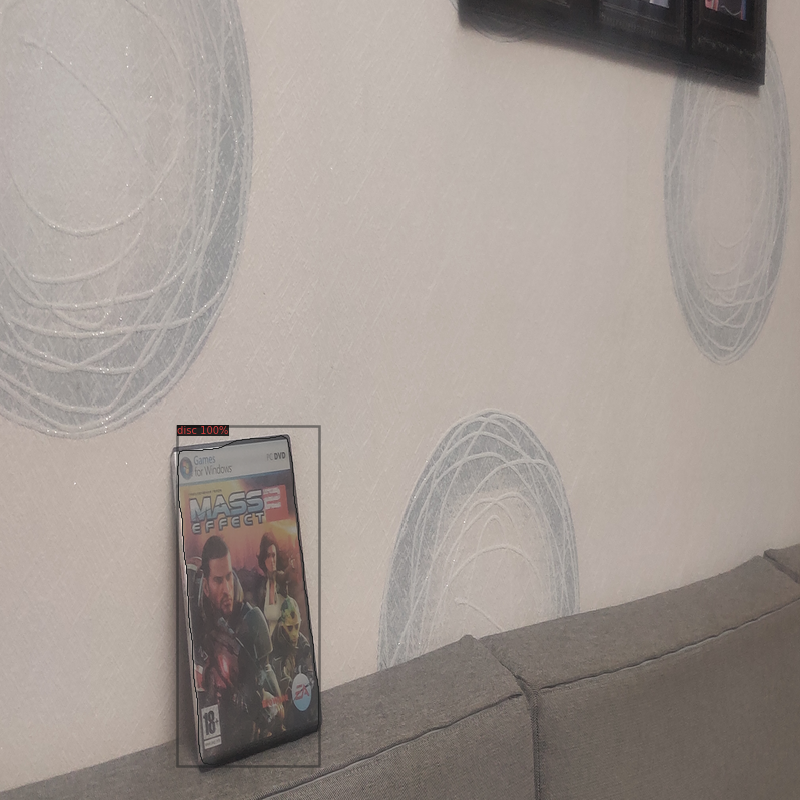

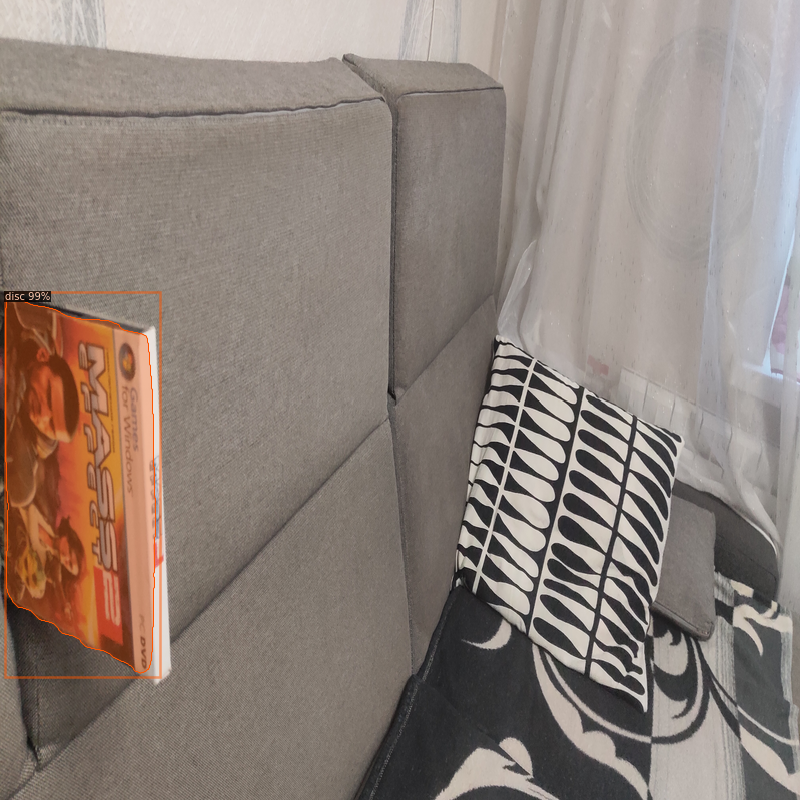

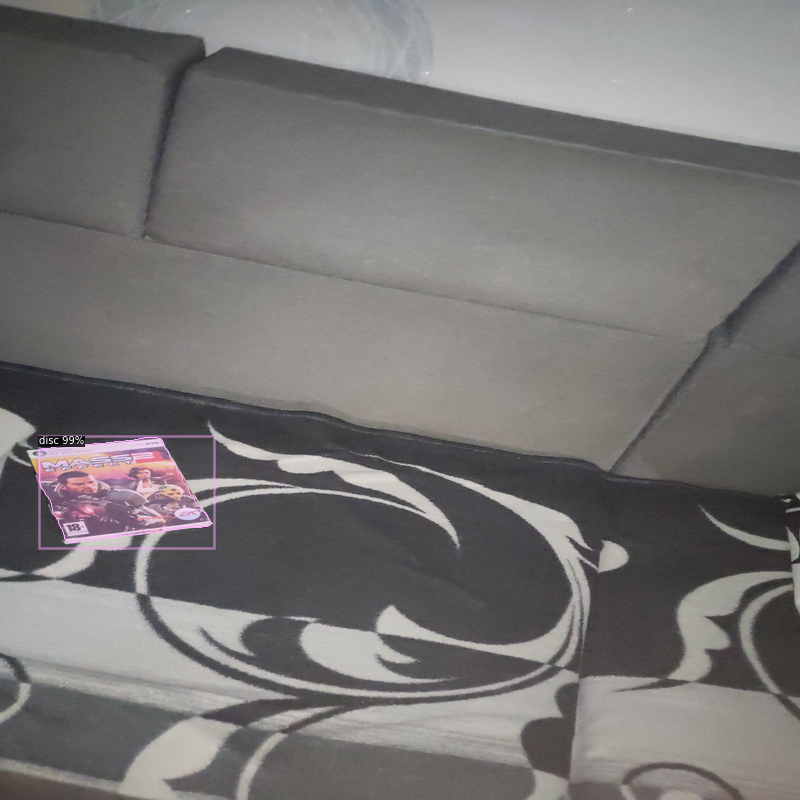

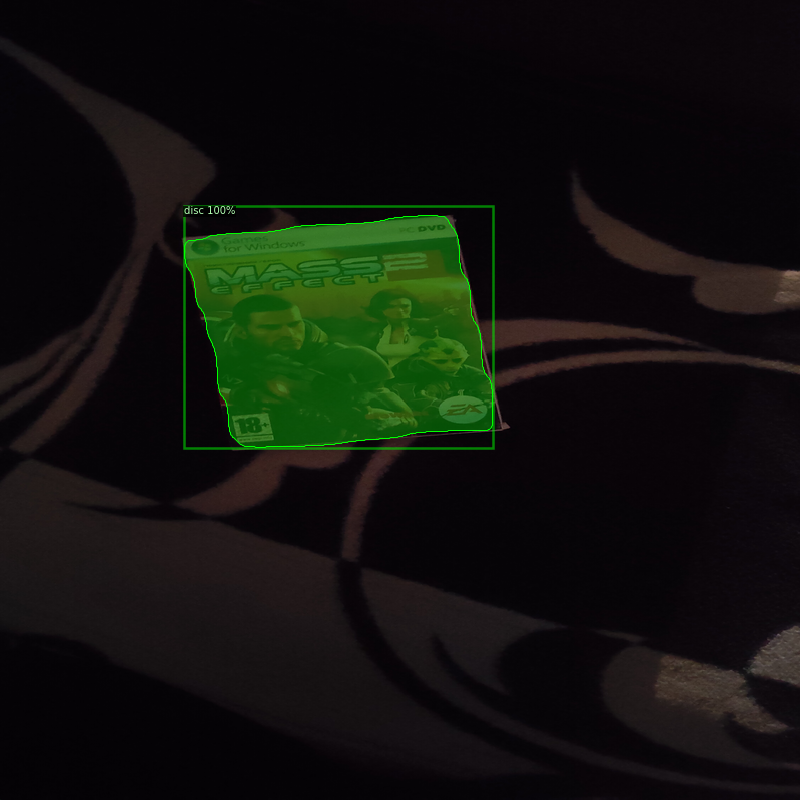

In [ ]:
from detectron2.utils.visualizer import ColorMode
aa=[]
import random
from detectron2.utils.visualizer import Visualizer
import cv2
from google.colab.patches import cv2_imshow
for d in random.sample(dataset_dicts, 15):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    boxes=next(iter(outputs['instances'].pred_boxes)).cpu().numpy()
    v = Visualizer(im[:, :, ::-1],
                   metadata=disc_metadata, 
                   scale=1, 
                   instance_mode=ColorMode.IMAGE_BW 
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

In [ ]:
from skimage.transform import ProjectiveTransform
from skimage.io import imread
import numpy as np
import matplotlib.pylab as plt

In [ ]:
from pylab import rcParams
rcParams['figure.figsize'] = 20, 20

In [10]:
!pip install pytube
import pytube
import os
import cv2
url = 'https://www.youtube.com/watch?v=0JE4WXw4VFs&ab_channel=WolfConservationCenter'
pytube.YouTube(url).streams.get_highest_resolution().download('video')
video_path='content/video/'+os.listdir('/content/video')[0]
capture = cv2.VideoCapture(video_path)
!rm -r '/content/video'

In [ ]:
cfg.MODEL.WEIGHTS = '/content/drive/MyDrive/model_final.pth'
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.8  
cfg.DATASETS.TEST = ("discs", )
predictor = DefaultPredictor(cfg)
font = cv2.FONT_HERSHEY_SIMPLEX
capture = cv2.VideoCapture("/content/drive/MyDrive/me_video.mp4")
fourcc = cv2.VideoWriter_fourcc(*'DIVX')
fps = 30
w, h = 800, 800
stream = cv2.VideoWriter("/content/drive/MyDrive/disc_maskrcnn.avi", fourcc, fps, (w, h))
i=0
capture2 = cv2.VideoCapture("/content/drive/MyDrive/teaser.mp4")
banners=[]
detect_time=[]
all_actions_time=[]
while capture2.isOpened():
    ret2, frame2 = capture2.read()
    if i%5==0:
      banners.append(frame2)
    if ret2 == False:
          break
i=0
while capture.isOpened():
    ret, frame = capture.read()
    if ret == False:
        break
    frame=cv2.resize(frame, (800,800), interpolation = cv2.INTER_AREA)
    try:
        detect_start=time.time()
        all_actions_start=time.time()
        outputs = predictor(frame)
        detect_end=time.time()
        detect_time.append(detect_end-detect_start)
        banner =banners[i]
        i+=1
        gray=outputs['instances'].pred_masks.cpu().numpy()[0].astype(np.uint8)*255
        et,thresh = cv2.threshold(gray,127,255,0)
        contours,hierarchy = cv2.findContours(thresh,1, 2)
        cnt = contours[0]
        epsilon = 0.1*cv2.arcLength(cnt,True)
        approx = cv2.approxPolyDP(cnt,epsilon,True)
        box = np.int0(approx)
        frameClone = frame.copy()
        pts_frame = box.reshape(4,2)
        pts_banner = np.array([[0, 0], [banner.shape[1] - 1, 0], [banner.shape[1] - 1, banner.shape[0] - 1], [0, banner.shape[0] - 1]])
        print("Detect")
        homographyMat, status = cv2.findHomography(pts_banner, pts_frame, cv2.RANSAC,5.0)
        result1 = cv2.warpPerspective(banner, homographyMat, (frame.shape[1], frame.shape[0]))
        cv2.fillConvexPoly(frameClone, pts_frame, 0, 16)
        frame = frameClone + result1
        all_actions_end=time.time()
        all_actions_time.append(all_actions_end-all_actions_start)
    except:
      print("NO OBJECT")
    stream.write(frame)
    if cv2.waitKey(25) == ord('q'):
        break
    
capture.release()
stream.release()
cv2.destroyAllWindows()

In [ ]:
f=open('f1_detectionTime.txt','w')
s1='\n'.join(detect_time)
f.write(s1)
f.close()
f=open('f1_insertingTime.txt','w')
s1='\n'.join(detect_time)
f.write(s1)
f.close()

In [ ]:
from moviepy.editor import *

path="/content/drive/MyDrive/disc_maskrcnn.avi" 

clip=VideoFileClip(path)
clip.ipython_display(width=800)


100%|██████████| 757/757 [00:07<00:00, 95.06it/s]
